<a href="https://colab.research.google.com/github/seongmin-mo/Final-Team8/blob/main/FinalProject8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#결론

💡전체적인 불량의 원인은 불안정한 공정 운영이다.
- 공정 변수를 적절한 범위 안에서 제어할 필요가 있다.
- 공정 범위는 <불량구간> 참고

💡상관계수, 로지스틱 회귀, 머신러닝 SHAP를 통해 불량 여부에 가장 큰 영향을 끼치는 변수를 알아보았다.
- 속도/시간 관련 변수에서는 저속속도가 가장 중요한 변수
- 저속속도는 공정 과정의 가장 초기 단계에 해당하는 변수로 고속속도, 스프레이, 고속절환위치, 주조압력과 함께 작용하여 불량률에 영향을 미친다.
- 저속속도 0.3~0.4m/s 이내에서 운전해야 한다.

#데이터 불러오기

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
%%capture
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
fm.fontManager.addfont('/usr/share/fonts/truetype/nanum/NanumGothic.ttf')
plt.rcParams['font.family'] = 'NanumGothic'

In [5]:
plt.rcParams['axes.unicode_minus'] = False

##데이터

💡데이터 출처: KAMP(인공지능제조플랫폼)-알루미늄 주조 파라미터 및 센서 제조AI데이터셋, (주)코넥-큐빅테크
[KAMP](https://www.kamp-ai.kr/proveDataDetail?AI_SEARCH=&page=2&DATASET_SEQ=49&DISPLAY_MODE_SEL=CARD&SECTOR_SEL=&TARGET_SEL=&FILE_TYPE_SEL=&SORT_SEL=CLICK_NUM)

[코넥 홈페이지](http://www.konecauto.com/home/sub0302.php)

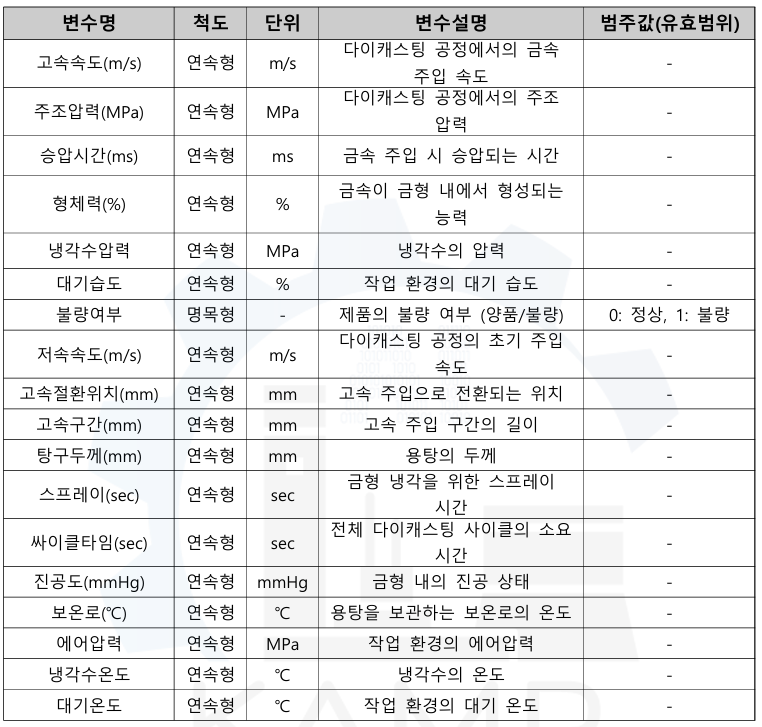

🔍참고자료
- 다이캐스팅 공정 및 품질관리, 한국주조공학회지 제42권 제6호 379-386p, 천정권, 2022
[디비피아](https://www.dbpia.co.kr/journal/articleDetail?nodeId=NODE12308628)

- 마그네슘 합금 박육 부품 다이캐스팅 주조시 오버플로우 형상 및 주입속도가 주조 품질에 미치는 영향, 대한금속 재료학회지, 권의혁 외 3인, 2017
- Al 박육 다이캐스팅 주물에서 기포결함에 미치는 주물두께, 사출속도의 영향, 한국주조공학회지, 강호정 외 4인, 2015

In [8]:
df = pd.read_csv('/content/제조AI데이터셋_(주)코넥.csv', encoding='cp949')

In [9]:
df.head()

,Unnamed: 0,저속속도(m/s),고속속도(m/s),고속절환위치(mm),고속구간(mm),주조압력(MPa),탕구두께(mm),승압시간(ms),스프레이(sec),싸이클타임(sec),형체력(%),진공도(mmHg),보온로(℃),에어압력,냉각수온도,냉각수압력,대기온도,대기습도,불량여부
0,0,0.34,2.19,708,201,68.7,31,102,18.5,58.4,98,742,666,6.420,21.667,3.928,17.471,61.838,1
1,1,0.34,2.19,709,199,68.8,31,102,18.5,58.2,98,741,666,6.433,21.667,3.957,17.492,61.809,1
2,2,0.34,2.20,695,210,68.4,35,125,18.5,58.4,97,738,670,6.297,19.000,3.689,17.671,64.666,1
3,3,0.34,2.19,696,210,68.5,35,122,18.5,58.4,97,739,670,6.243,19.000,3.705,17.737,64.543,1
4,4,0.34,2.19,706,202,68.7,34,118,18.5,58.4,98,738,670,6.287,19.000,3.728,17.875,64.825,1


In [10]:
df=df.drop('Unnamed: 0',axis=1)

In [11]:
df['불량여부'].value_counts()

,count
불량여부,
1,43644
0,43644


데이터셋은 이미 기업 측에서 정제 및 전처리를 한 것이고, 추후 머신러닝에 용이하도록 불량/양품 데이터 개수를 맞춘 것으로 보임

##가설설정

💡속도, 시간과 관련있는 변수

- 저속속도(m/s)

- 고속속도(m/s)

- 고속절환위치(mm)

- 고속구간(mm)

- 스프레이(sec)

- 사이클타임(sec)


#데이터 관계 시각화

##산점도

###불량여부 - 저속속도

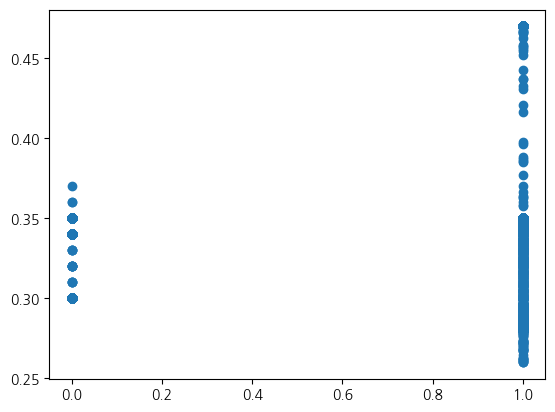

In [ ]:
plt.scatter(df['불량여부'],df['저속속도(m/s)'])
plt.show()

###불량여부 - 고속속도

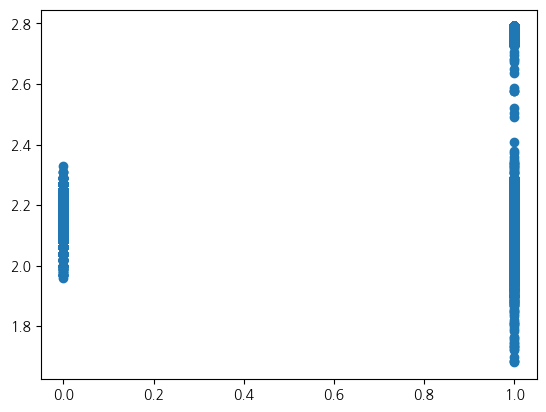

In [ ]:
plt.scatter(df['불량여부'],df['고속속도(m/s)'])
plt.show()

###불량여부 - 고속절환위치

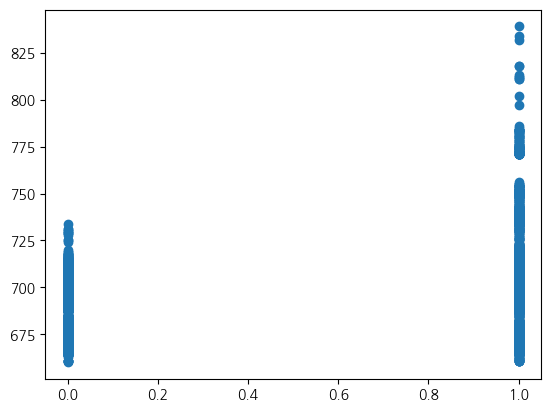

In [ ]:
plt.scatter(df['불량여부'],df['고속절환위치(mm)'])
plt.show()

###불량여부 - 고속구간

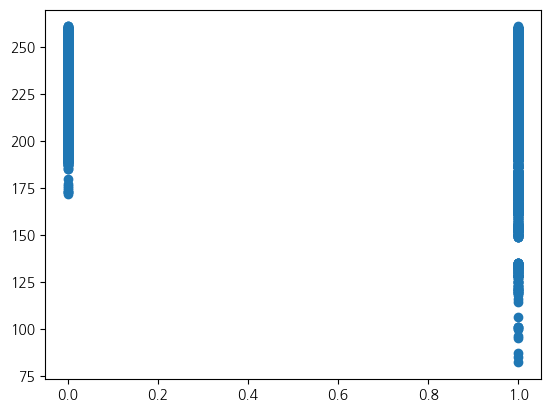

In [ ]:
plt.scatter(df['불량여부'],df['고속구간(mm)'])
plt.show()

###불량여부 - 스프레이시간

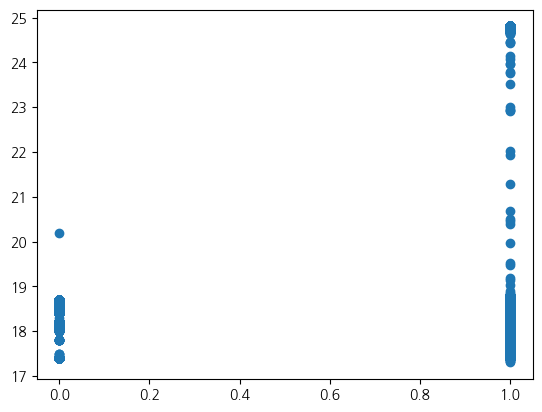

In [ ]:
plt.scatter(df['불량여부'],df['스프레이(sec)'])
plt.show()

###불량여부 - 싸이클타임

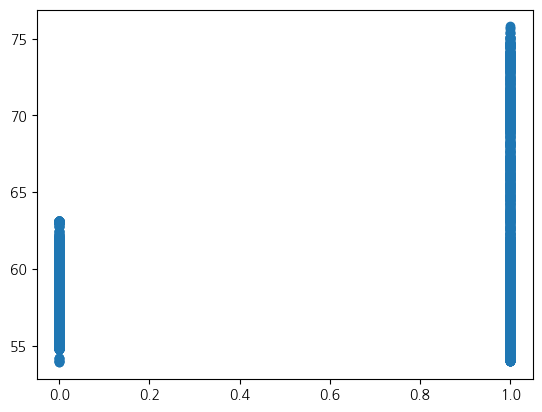

In [ ]:
plt.scatter(df['불량여부'],df['싸이클타임(sec)'])
plt.show()

##불량구간

###저속속도

In [ ]:
df_false=df[df['불량여부']==1]
df_true=df[df['불량여부']==0]

In [ ]:
lowspeed_f_max=df_false['저속속도(m/s)'].max()
lowspeed_f_min=df_false['저속속도(m/s)'].min()
lowspeed_t_max=df_true['저속속도(m/s)'].max()
lowspeed_t_min=df_true['저속속도(m/s)'].min()

In [ ]:
print(lowspeed_f_min)
print('----양품----')
print(lowspeed_t_min)
print(lowspeed_t_max)
print('----양품----')
print(lowspeed_f_max)

0.26
----양품----
0.3
0.37
----양품----
0.47


###고속속도

In [ ]:
fastspeed_f_max=df_false['고속속도(m/s)'].max()
fastspeed_f_min=df_false['고속속도(m/s)'].min()
fastspeed_t_max=df_true['고속속도(m/s)'].max()
fastspeed_t_min=df_true['고속속도(m/s)'].min()

In [ ]:
print(fastspeed_f_min)
print('----양품----')
print(fastspeed_t_min)
print(fastspeed_t_max)
print('----양품----')
print(fastspeed_f_max)

1.68
----양품----
1.96
2.33
----양품----
2.79


###고속절환위치

In [ ]:
switch_f_max=df_false['고속절환위치(mm)'].max()
switch_f_min=df_false['고속절환위치(mm)'].min()
switch_t_max=df_true['고속절환위치(mm)'].max()
switch_t_min=df_true['고속절환위치(mm)'].min()

In [ ]:
print(switch_f_min)
print('----양품----')
print(switch_t_min)
print(switch_t_max)
print('----양품----')
print(switch_f_max)

661
----양품----
660
734
----양품----
839


###고속구간

In [ ]:
section_f_max=df_false['고속구간(mm)'].max()
section_f_min=df_false['고속구간(mm)'].min()
section_t_max=df_true['고속구간(mm)'].max()
section_t_min=df_true['고속구간(mm)'].min()

In [ ]:
print(section_f_min)
print('----양품----')
print(section_t_min)
print(section_t_max)
print('----양품----')
print(section_f_max)

82
----양품----
172
261
----양품----
261


###스프레이

In [ ]:
spray_f_max=df_false['스프레이(sec)'].max()
spray_f_min=df_false['스프레이(sec)'].min()
spray_t_max=df_true['스프레이(sec)'].max()
spray_t_min=df_true['스프레이(sec)'].min()

In [ ]:
print(spray_f_min)
print('----양품----')
print(spray_t_min)
print(spray_t_max)
print('----양품----')
print(spray_f_max)

17.3
----양품----
17.4
20.2
----양품----
24.8


###싸이클타임

In [ ]:
cycle_f_max=df_false['싸이클타임(sec)'].max()
cycle_f_min=df_false['싸이클타임(sec)'].min()
cycle_t_max=df_true['싸이클타임(sec)'].max()
cycle_t_min=df_true['싸이클타임(sec)'].min()

In [ ]:
print(cycle_f_min)
print('----양품----')
print(cycle_t_min)
print(cycle_t_max)
print('----양품----')
print(cycle_f_max)

54.0
----양품----
53.9
63.1
----양품----
75.8


##히스토그램

###저속속도

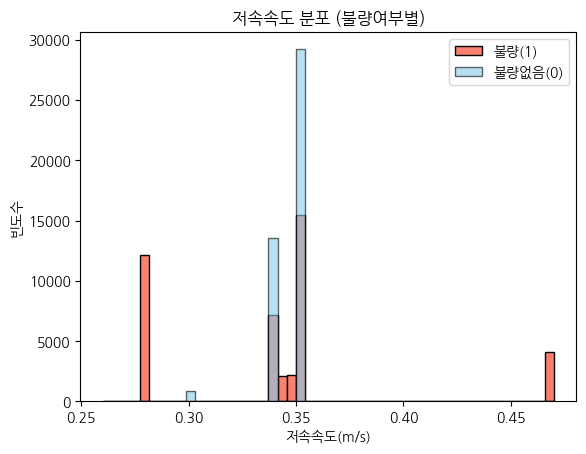

In [ ]:
lowspeed_t = df[df['불량여부'] == 0]['저속속도(m/s)']
lowspeed_f = df[df['불량여부'] == 1]['저속속도(m/s)']

min_val = min(df['저속속도(m/s)'])
max_val = max(df['저속속도(m/s)'])
bins = np.linspace(min_val, max_val, 50)

plt.hist(lowspeed_f, bins=bins, label='불량(1)', color='salmon', edgecolor='black')
plt.hist(lowspeed_t, bins=bins, alpha=0.6, label='불량없음(0)', color='skyblue', edgecolor='black')

plt.title("저속속도 분포 (불량여부별)")
plt.xlabel("저속속도(m/s)")
plt.ylabel("빈도수")
plt.legend()
plt.savefig("lowspeed.png")
plt.show()

###고속속도

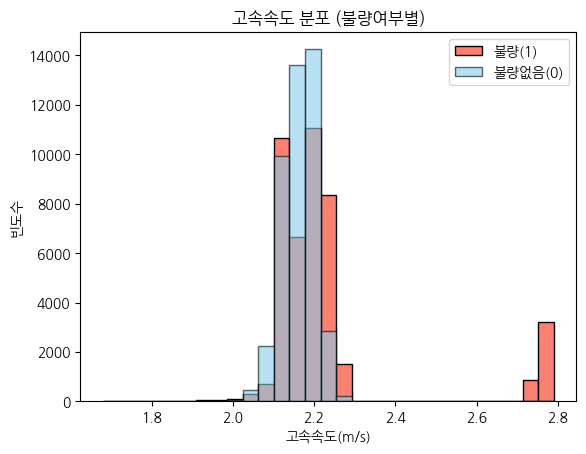

In [ ]:
fastspeed_t = df[df['불량여부'] == 0]['고속속도(m/s)']
fastspeed_f = df[df['불량여부'] == 1]['고속속도(m/s)']

min_val = min(df['고속속도(m/s)'])
max_val = max(df['고속속도(m/s)'])
bins = np.linspace(min_val, max_val, 30)

plt.hist(fastspeed_f, bins=bins, label='불량(1)', color='salmon', edgecolor='black')
plt.hist(fastspeed_t, bins=bins, alpha=0.6, label='불량없음(0)', color='skyblue', edgecolor='black')

plt.title("고속속도 분포 (불량여부별)")
plt.xlabel("고속속도(m/s)")
plt.ylabel("빈도수")
plt.legend()
plt.show()

###고속절환위치

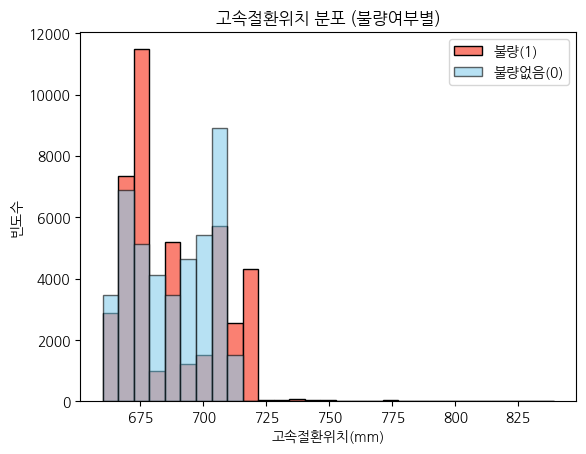

In [ ]:
switch_t = df[df['불량여부'] == 0]['고속절환위치(mm)']
switch_f  = df[df['불량여부'] == 1]['고속절환위치(mm)']

min_val = min(df['고속절환위치(mm)'])
max_val = max(df['고속절환위치(mm)'])
bins = np.linspace(min_val, max_val, 30)

plt.hist(switch_f, bins=bins, label='불량(1)', color='salmon', edgecolor='black')
plt.hist(switch_t, bins=bins, alpha=0.6, label='불량없음(0)', color='skyblue', edgecolor='black')

plt.title("고속절환위치 분포 (불량여부별)")
plt.xlabel("고속절환위치(mm)")
plt.ylabel("빈도수")
plt.legend()
plt.show()

###고속구간

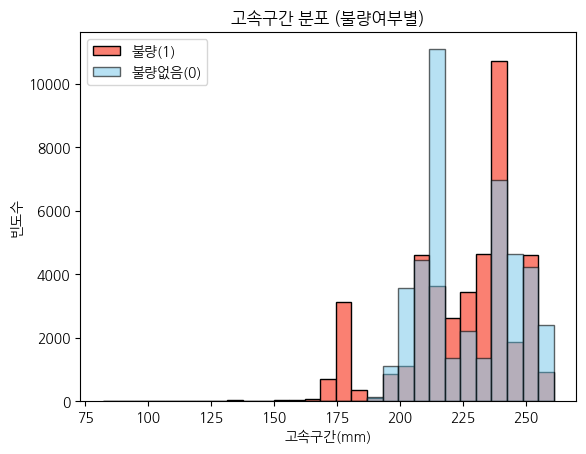

In [ ]:
section_t = df[df['불량여부'] == 0]['고속구간(mm)']
section_f = df[df['불량여부'] == 1]['고속구간(mm)']

min_val = min(df['고속구간(mm)'])
max_val = max(df['고속구간(mm)'])
bins = np.linspace(min_val, max_val, 30)

plt.hist(section_f, bins=bins, label='불량(1)', color='salmon', edgecolor='black')
plt.hist(section_t, bins=bins, alpha=0.6, label='불량없음(0)', color='skyblue', edgecolor='black')

plt.title("고속구간 분포 (불량여부별)")
plt.xlabel("고속구간(mm)")
plt.ylabel("빈도수")
plt.legend()
plt.show()

###스프레이

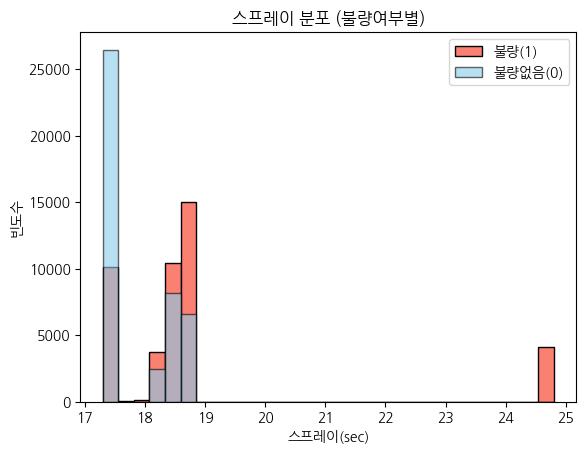

In [ ]:
spray_t = df[df['불량여부'] == 0]['스프레이(sec)']
spray_f = df[df['불량여부'] == 1]['스프레이(sec)']

min_val = min(df['스프레이(sec)'])
max_val = max(df['스프레이(sec)'])
bins = np.linspace(min_val, max_val, 30)

plt.hist(spray_f, bins=bins, label='불량(1)', color='salmon', edgecolor='black')
plt.hist(spray_t, bins=bins, alpha=0.6, label='불량없음(0)', color='skyblue', edgecolor='black')

plt.title("스프레이 분포 (불량여부별)")
plt.xlabel("스프레이(sec)")
plt.ylabel("빈도수")
plt.legend()
plt.show()

###싸이클타임

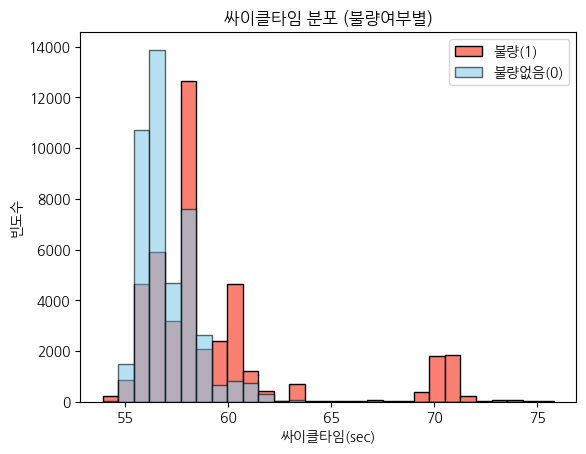

In [ ]:
cycle_t = df[df['불량여부'] == 0]['싸이클타임(sec)']
cycle_f = df[df['불량여부'] == 1]['싸이클타임(sec)']

min_val = min(df['싸이클타임(sec)'])
max_val = max(df['싸이클타임(sec)'])
bins = np.linspace(min_val, max_val, 30)

plt.hist(cycle_f, bins=bins, label='불량(1)', color='salmon', edgecolor='black')
plt.hist(cycle_t, bins=bins, alpha=0.6, label='불량없음(0)', color='skyblue', edgecolor='black')

plt.title("싸이클타임 분포 (불량여부별)")
plt.xlabel("싸이클타임(sec)")
plt.ylabel("빈도수")
plt.legend()
plt.show()

##히트맵-상관계수

In [ ]:
corr=df.corr()

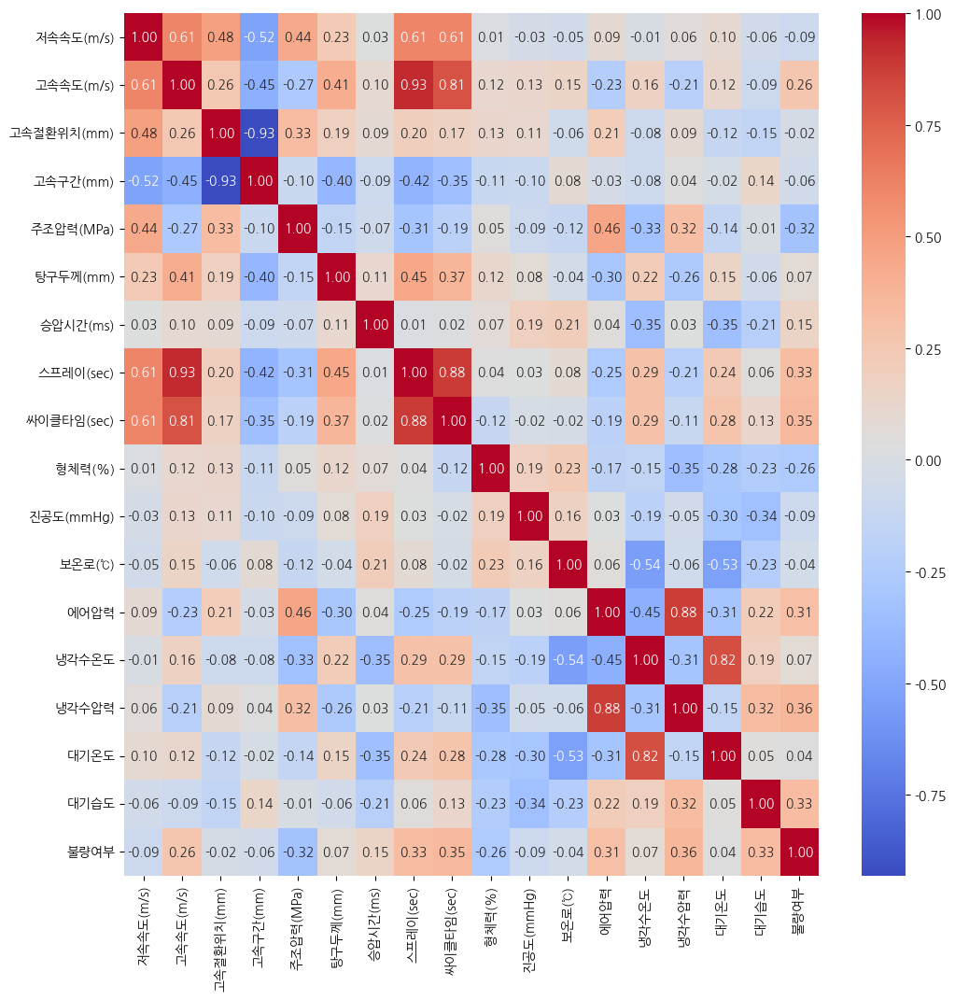

In [ ]:
plt.figure(figsize=(12,12))
sns.heatmap(corr,annot=True,cmap="coolwarm",fmt=".2f")
plt.savefig("heatmap.png")
plt.show()

#다른 변수와의 상관관계 고찰

##pairplot

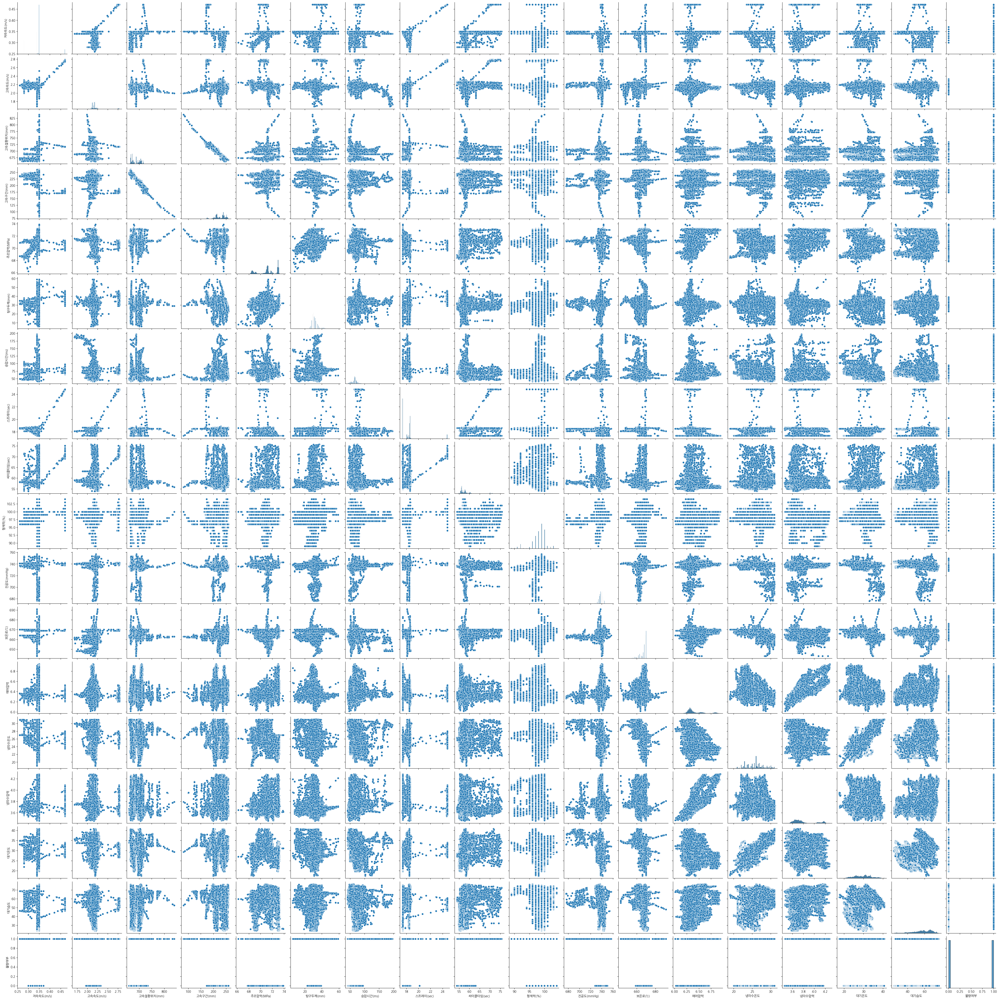

In [ ]:
sns.pairplot(df[[
    "저속속도(m/s)",
    "고속속도(m/s)",
    "고속절환위치(mm)",
    "고속구간(mm)",
    "주조압력(MPa)",
    "탕구두께(mm)",
    "승압시간(ms)",
    "스프레이(sec)",
    "싸이클타임(sec)",
    "형체력(%)",
    "진공도(mmHg)",
    "보온로(℃)",
    "에어압력",
    "냉각수온도",
    "냉각수압력",
    "대기온도",
    "대기습도",
    "불량여부"]])

##다중공선성 확인

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm

In [ ]:
X=df.copy()

In [ ]:
X = X.drop(['불량여부'],axis=1)

In [ ]:
X_const = sm.add_constant(X)
vif = pd.DataFrame()
vif["feature"] = X_const.columns
vif["VIF"] = [variance_inflation_factor(X_const.values, i)
              for i in range(X_const.shape[1])]
print(vif)

       feature            VIF
0        const  162232.434758
1    저속속도(m/s)       7.629608
2    고속속도(m/s)      10.217405
3   고속절환위치(mm)      29.183933
4     고속구간(mm)      32.484302
5    주조압력(MPa)       7.402479
6     탕구두께(mm)       2.181686
7     승압시간(ms)       1.363381
8    스프레이(sec)      18.276619
9   싸이클타임(sec)       5.619464
10      형체력(%)       1.574547
11   진공도(mmHg)       1.412165
12      보온로(℃)       2.034320
13        에어압력       6.993565
14       냉각수온도       5.639704
15       냉각수압력       6.481541
16        대기온도       5.186829
17        대기습도       2.130883


In [ ]:
#고속구간 제외(고속절환위치와 높은 상관성)

In [ ]:
X = df.drop(['불량여부','고속구간(mm)'],axis=1)

In [ ]:
X_const = sm.add_constant(X)
vif = pd.DataFrame()
vif["feature"] = X_const.columns
vif["VIF"] = [variance_inflation_factor(X_const.values, i)
              for i in range(X_const.shape[1])]
print(vif)

       feature            VIF
0        const  129397.692033
1    저속속도(m/s)       6.664541
2    고속속도(m/s)      10.195179
3   고속절환위치(mm)       1.646535
4    주조압력(MPa)       5.078525
5     탕구두께(mm)       1.446413
6     승압시간(ms)       1.356471
7    스프레이(sec)      18.245235
8   싸이클타임(sec)       5.602176
9       형체력(%)       1.574497
10   진공도(mmHg)       1.406910
11      보온로(℃)       2.017997
12        에어압력       6.991779
13       냉각수온도       5.622399
14       냉각수압력       6.467823
15        대기온도       5.083807
16        대기습도       2.122379


In [ ]:
X = df.drop(['불량여부','고속구간(mm)','싸이클타임(sec)'],axis=1)

In [ ]:
X_const = sm.add_constant(X)
vif = pd.DataFrame()
vif["feature"] = X_const.columns
vif["VIF"] = [variance_inflation_factor(X_const.values, i)
              for i in range(X_const.shape[1])]
print(vif)

       feature            VIF
0        const  128874.399896
1    저속속도(m/s)       6.652573
2    고속속도(m/s)      10.178941
3   고속절환위치(mm)       1.642965
4    주조압력(MPa)       5.005530
5     탕구두께(mm)       1.441810
6     승압시간(ms)       1.337948
7    스프레이(sec)      14.344550
8       형체력(%)       1.465745
9    진공도(mmHg)       1.401339
10      보온로(℃)       2.013816
11        에어압력       6.919439
12       냉각수온도       5.621614
13       냉각수압력       6.448902
14        대기온도       5.073886
15        대기습도       2.090368


##로지스틱회귀

In [ ]:
#고속구간, 싸이클타임 제거
from statsmodels.formula.api import logit
model=logit('Q("불량여부")~\
            Q("저속속도(m/s)")\
            +Q("고속절환위치(mm)")\
            +Q("주조압력(MPa)")\
            +Q("탕구두께(mm)")\
            +Q("승압시간(ms)")\
            +Q("스프레이(sec)")\
            +Q("형체력(%)")\
            +Q("진공도(mmHg)")\
            +Q("보온로(℃)")\
            +Q("에어압력")\
            +Q("냉각수온도")\
            +Q("냉각수압력")\
            +Q("대기온도")\
            +Q("대기습도")'
            ,data=df)
model_result=model.fit()
print(model_result.summary())

Optimization terminated successfully.
         Current function value: 0.234226
         Iterations 10
                           Logit Regression Results                           
Dep. Variable:              Q("불량여부")   No. Observations:                87288
Model:                          Logit   Df Residuals:                    87273
Method:                           MLE   Df Model:                           14
Date:                Fri, 19 Sep 2025   Pseudo R-squ.:                  0.6621
Time:                        07:29:38   Log-Likelihood:                -20445.
converged:                       True   LL-Null:                       -60503.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept         225.3780      6.155     36.620      0.000     213.315     237.441
Q("저속속도(m/s)"

In [ ]:
#모든변수 포함
from statsmodels.formula.api import logit
model=logit('Q("불량여부")~\
            Q("저속속도(m/s)")\
            +Q("고속절환위치(mm)")\
            +Q("고속구간(mm)")\
            +Q("주조압력(MPa)")\
            +Q("탕구두께(mm)")\
            +Q("승압시간(ms)")\
            +Q("스프레이(sec)")\
            +Q("싸이클타임(sec)")\
            +Q("형체력(%)")\
            +Q("진공도(mmHg)")\
            +Q("보온로(℃)")\
            +Q("에어압력")\
            +Q("냉각수온도")\
            +Q("냉각수압력")\
            +Q("대기온도")\
            +Q("대기습도")'
            ,data=df)
model_result=model.fit()
print(model_result.summary())

Optimization terminated successfully.
         Current function value: 0.216881
         Iterations 10
                           Logit Regression Results                           
Dep. Variable:              Q("불량여부")   No. Observations:                87288
Model:                          Logit   Df Residuals:                    87271
Method:                           MLE   Df Model:                           16
Date:                Fri, 19 Sep 2025   Pseudo R-squ.:                  0.6871
Time:                        07:30:26   Log-Likelihood:                -18931.
converged:                       True   LL-Null:                       -60503.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept         343.0011      7.224     47.484      0.000     328.843     357.159
Q("저속속도(m/s)"

저속속도 유의

##히트맵

저속속도가 다른 변수들과 연관관계가 높은 것으로 보임

In [12]:
df_bin=df.copy()

###저속속도 - 고속속도

/tmp/ipython-input-1160015651.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df_bin.groupby(['저속속도_bin','고속속도_bin'])['불량여부'].mean().unstack()


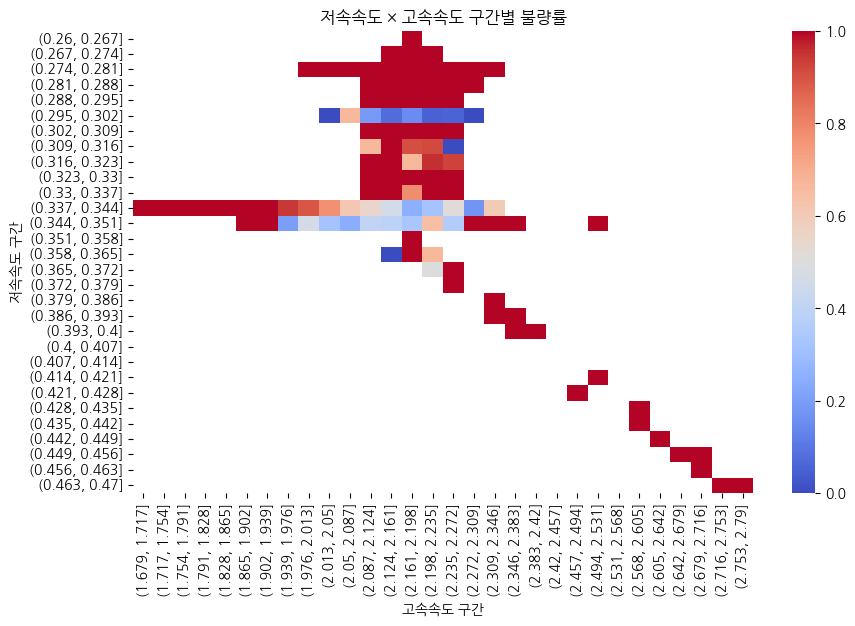

In [13]:
df_bin['저속속도_bin'] = pd.cut(df['저속속도(m/s)'], bins=30)
df_bin['고속속도_bin'] = pd.cut(df['고속속도(m/s)'], bins=30)

heatmap_data = df_bin.groupby(['저속속도_bin','고속속도_bin'])['불량여부'].mean().unstack()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap='coolwarm')
plt.ylabel('저속속도 구간')
plt.xlabel('고속속도 구간')
plt.title('저속속도 × 고속속도 구간별 불량률')

plt.show()

###저속속도 - 고속절환위치

/tmp/ipython-input-321612716.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df_bin.groupby(['저속속도_bin','고속절환위치_bin'])['불량여부'].mean().unstack()


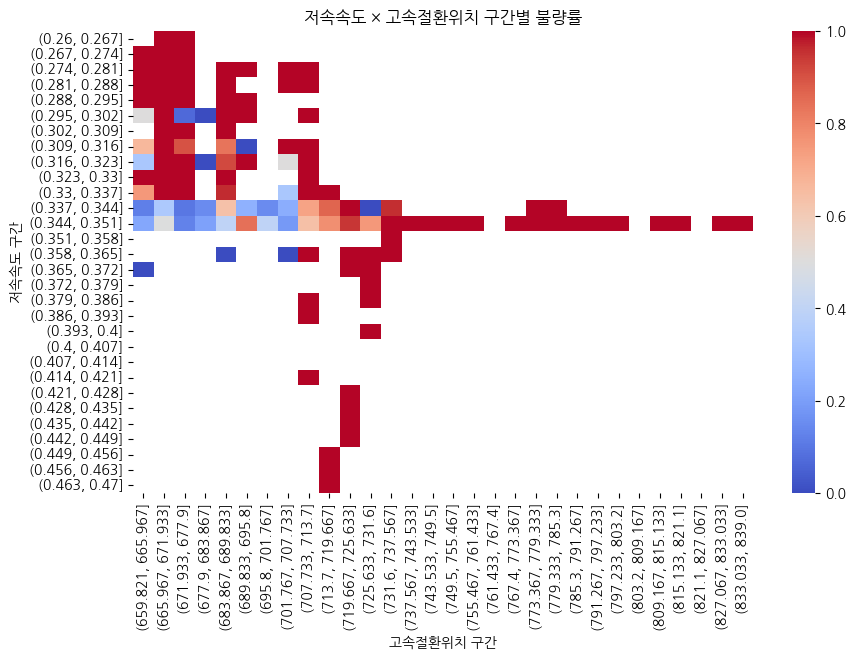

In [ ]:
df_bin['고속절환위치_bin'] = pd.cut(df['고속절환위치(mm)'], bins=30)
heatmap_data = df_bin.groupby(['저속속도_bin','고속절환위치_bin'])['불량여부'].mean().unstack()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap='coolwarm')
plt.ylabel('저속속도 구간')
plt.xlabel('고속절환위치 구간')
plt.title('저속속도 × 고속절환위치 구간별 불량률')

plt.show()

###저속속도 - 고속구간

/tmp/ipython-input-857502317.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df_bin.groupby(['저속속도_bin','고속구간_bin'])['불량여부'].mean().unstack()


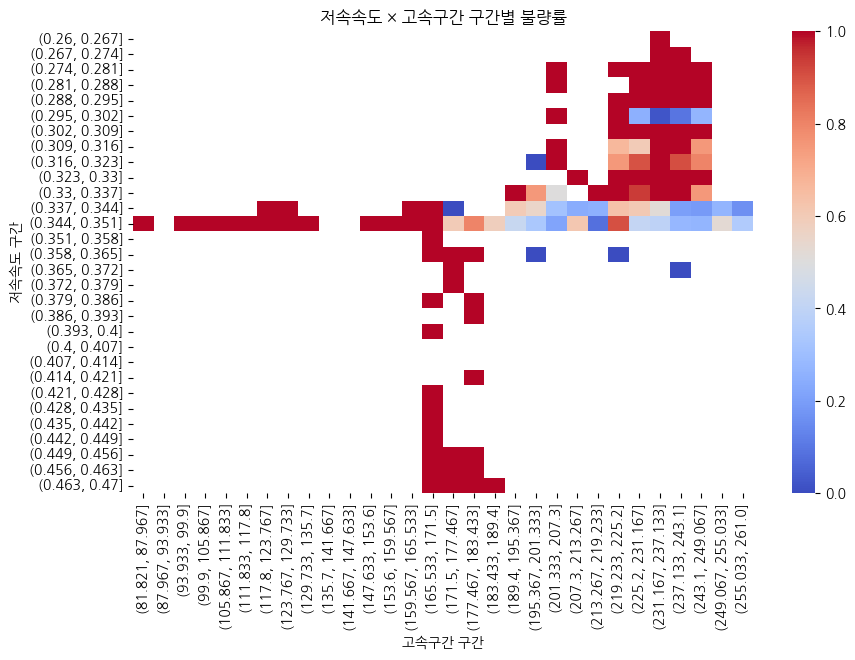

In [ ]:
df_bin['고속구간_bin'] = pd.cut(df['고속구간(mm)'], bins=30)
heatmap_data = df_bin.groupby(['저속속도_bin','고속구간_bin'])['불량여부'].mean().unstack()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap='coolwarm')
plt.ylabel('저속속도 구간')
plt.xlabel('고속구간 구간')
plt.title('저속속도 × 고속구간 구간별 불량률')

plt.show()

###저속속도 - 주조압력

/tmp/ipython-input-1102888875.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df_bin.groupby(['저속속도_bin','주조압력_bin'])['불량여부'].mean().unstack()


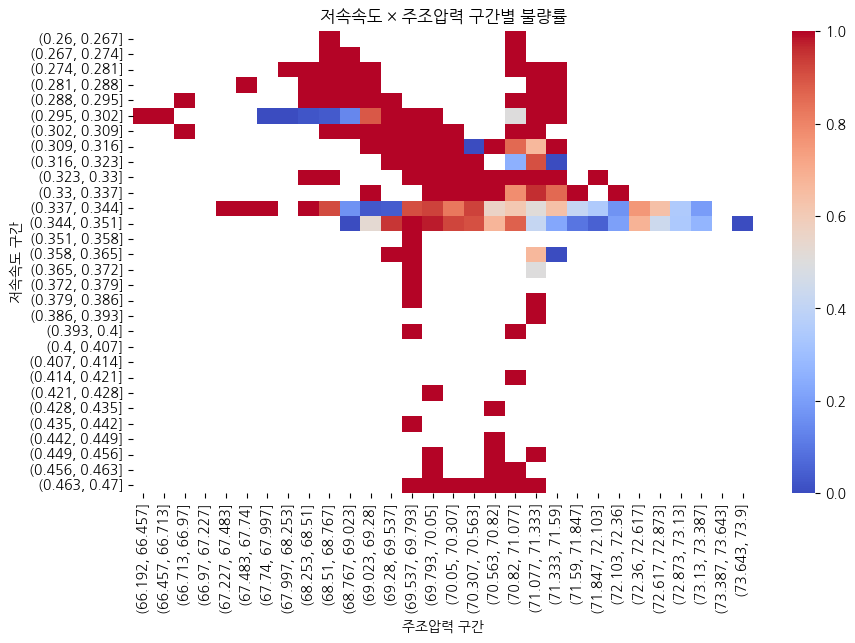

In [ ]:
df_bin['주조압력_bin'] = pd.cut(df['주조압력(MPa)'], bins=30)
heatmap_data = df_bin.groupby(['저속속도_bin','주조압력_bin'])['불량여부'].mean().unstack()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap='coolwarm')
plt.ylabel('저속속도 구간')
plt.xlabel('주조압력 구간')
plt.title('저속속도 × 주조압력 구간별 불량률')

plt.show()

주조압력 - 저속속도 관련 있어 보임

###저속속도 - 탕구두께

/tmp/ipython-input-444302584.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df_bin.groupby(['저속속도_bin','탕구두께_bin'])['불량여부'].mean().unstack()


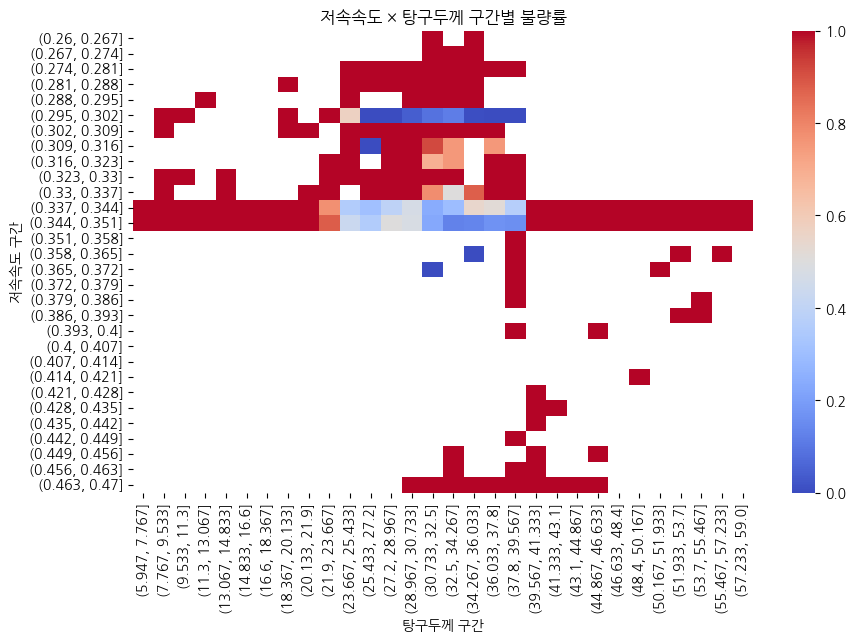

In [ ]:
df_bin['탕구두께_bin'] = pd.cut(df['탕구두께(mm)'], bins=30)
heatmap_data = df_bin.groupby(['저속속도_bin','탕구두께_bin'])['불량여부'].mean().unstack()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap='coolwarm')
plt.ylabel('저속속도 구간')
plt.xlabel('탕구두께 구간')
plt.title('저속속도 × 탕구두께 구간별 불량률')

plt.show()

###저속속도 - 스프레이

/tmp/ipython-input-4204250598.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df_bin.groupby(['저속속도_bin','스프레이_bin'])['불량여부'].mean().unstack()


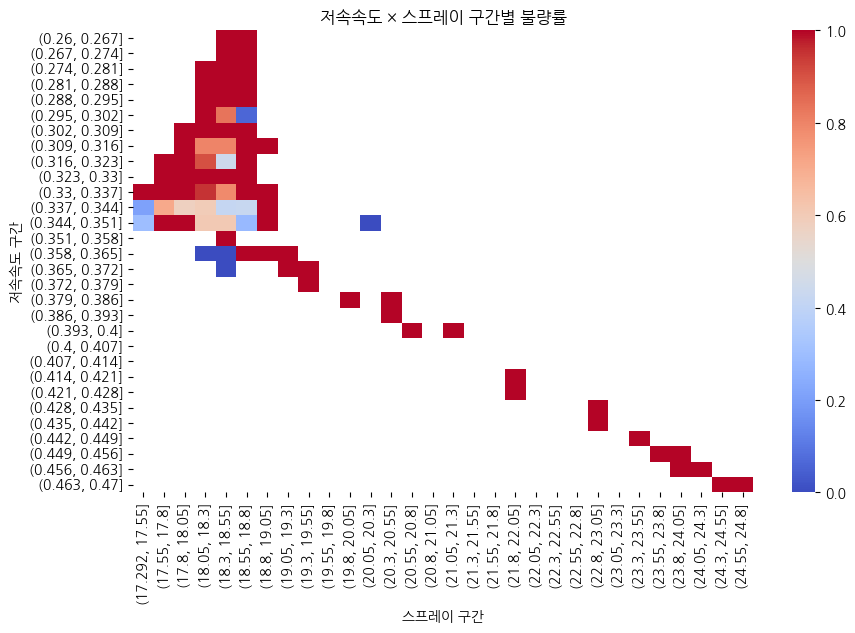

In [ ]:
df_bin['스프레이_bin'] = pd.cut(df['스프레이(sec)'], bins=30)
heatmap_data = df_bin.groupby(['저속속도_bin','스프레이_bin'])['불량여부'].mean().unstack()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap='coolwarm')
plt.ylabel('저속속도 구간')
plt.xlabel('스프레이 구간')
plt.title('저속속도 × 스프레이 구간별 불량률')

plt.show()

###고속속도 - 스프레이

고속속도와 스프레이타임이 상관계수가 높음

/tmp/ipython-input-181740009.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  heatmap_data = df_bin.groupby(['고속속도_bin','스프레이_bin'])['불량여부'].mean().unstack()


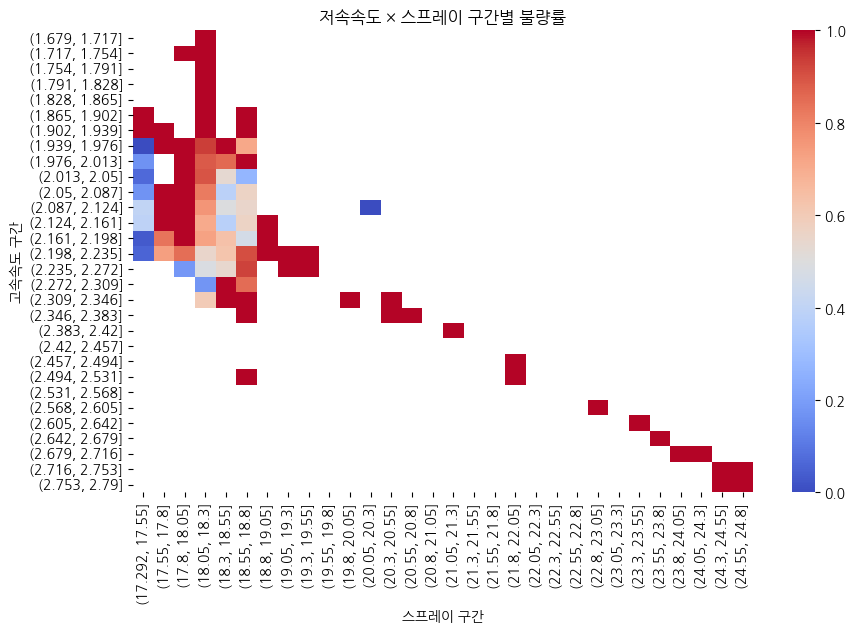

In [ ]:
heatmap_data = df_bin.groupby(['고속속도_bin','스프레이_bin'])['불량여부'].mean().unstack()

plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap='coolwarm')
plt.ylabel('고속속도 구간')
plt.xlabel('스프레이 구간')
plt.title('저속속도 × 스프레이 구간별 불량률')

plt.show()

고속속도와 저속속도 모두 특정 스프레이 구간에서는 선형 관계를 가진다

##카이검정

###저속속도 - 고속속도

In [ ]:
from scipy.stats import chi2_contingency

In [ ]:
contingency = pd.crosstab(df_bin["저속속도_bin"], df_bin["고속속도_bin"])

In [ ]:
chi2, p, dof, expected = chi2_contingency(contingency)
print("\n카이제곱 통계량:", chi2)
print("p-value:", p)
print("자유도:", dof)


카이제곱 통계량: 638857.5989557419
p-value: 0.0
자유도: 729


### 저속속도 - 스프레이

In [ ]:
contingency = pd.crosstab(df_bin["저속속도_bin"], df_bin["스프레이_bin"])

In [ ]:
chi2, p, dof, expected = chi2_contingency(contingency)
print("\n카이제곱 통계량:", chi2)
print("p-value:", p)
print("자유도:", dof)


카이제곱 통계량: 851991.5752746444
p-value: 0.0
자유도: 567


#불량/양품 데이터셋 분리하여 분석

머신러닝을 염두하여 불량/양품 데이터 개수를 똑같이 맞춘 데이터이므로 실제 공정 상황과는 차이가 있는 것으로 보임. 분석에 있어서 다중공선성 등의 문제 발생

In [ ]:
df_false['불량여부'].value_counts()

,count
불량여부,
1,43644


In [ ]:
df_true['불량여부'].value_counts()

,count
불량여부,
0,43644


##다중공선성 확인

In [ ]:
#양품
X_true=df_true.drop(['불량여부','고속구간(mm)'],axis=1)
X_const = sm.add_constant(X_true)
vif = pd.DataFrame()
vif["feature"] = X_const.columns
vif["VIF"] = [variance_inflation_factor(X_const.values, i)
              for i in range(X_const.shape[1])]

print(vif)

       feature            VIF
0        const  313789.812973
1    저속속도(m/s)       1.642565
2    고속속도(m/s)       1.702688
3   고속절환위치(mm)       1.350090
4    주조압력(MPa)       3.254449
5     탕구두께(mm)       1.365137
6     승압시간(ms)       2.939983
7    스프레이(sec)       5.415603
8   싸이클타임(sec)       2.303124
9       형체력(%)       1.601799
10   진공도(mmHg)       2.302073
11      보온로(℃)       2.510698
12        에어압력       3.093272
13       냉각수온도       5.385975
14       냉각수압력       2.704300
15        대기온도       5.289904
16        대기습도       2.544339


In [ ]:
#불량
X_false=df_false.drop(['불량여부','고속구간(mm)'],axis=1)
X_const = sm.add_constant(X_false)
vif = pd.DataFrame()
vif["feature"] = X_const.columns
vif["VIF"] = [variance_inflation_factor(X_const.values, i)
              for i in range(X_const.shape[1])]

print(vif)

       feature            VIF
0        const  157479.384159
1    저속속도(m/s)      35.784733
2    고속속도(m/s)      19.982552
3   고속절환위치(mm)       2.502345
4    주조압력(MPa)      20.554845
5     탕구두께(mm)       2.126424
6     승압시간(ms)       1.285447
7    스프레이(sec)      54.967660
8   싸이클타임(sec)       6.386344
9       형체력(%)       2.407735
10   진공도(mmHg)       1.384578
11      보온로(℃)       2.988125
12        에어압력      17.981973
13       냉각수온도       9.350656
14       냉각수압력      10.389991
15        대기온도       9.377455
16        대기습도       2.883350


양품에 비해 불량일때 변수들 간 다중공선성이 많이 나타남.

불량은 복합적인 요인, 과정에 의해 나타남.

특히 VIF값이 가장 크게 나타나는 저속속도를 주의 깊게 볼 필요 있음.

##pairplot

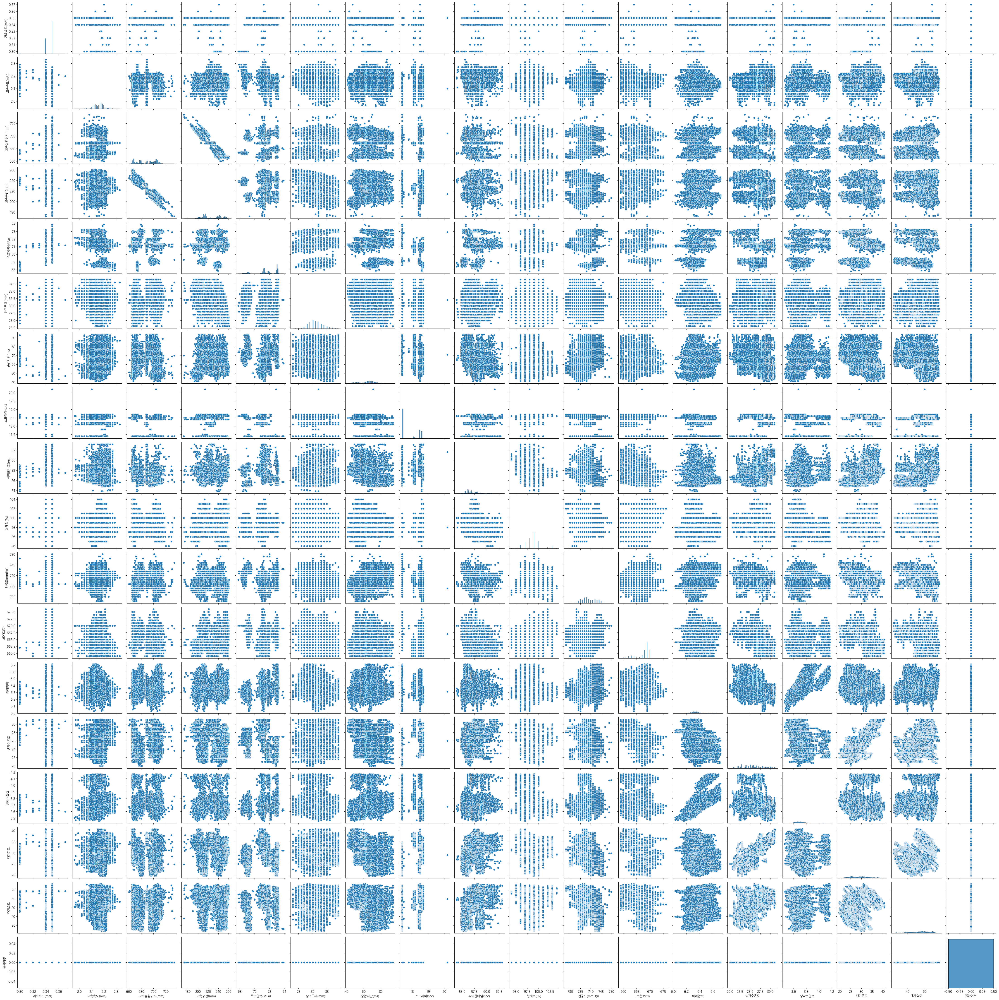

In [ ]:
#양품
sns.pairplot(df_true[[
    "저속속도(m/s)",
    "고속속도(m/s)",
    "고속절환위치(mm)",
    "고속구간(mm)",
    "주조압력(MPa)",
    "탕구두께(mm)",
    "승압시간(ms)",
    "스프레이(sec)",
    "싸이클타임(sec)",
    "형체력(%)",
    "진공도(mmHg)",
    "보온로(℃)",
    "에어압력",
    "냉각수온도",
    "냉각수압력",
    "대기온도",
    "대기습도",
    "불량여부"]])

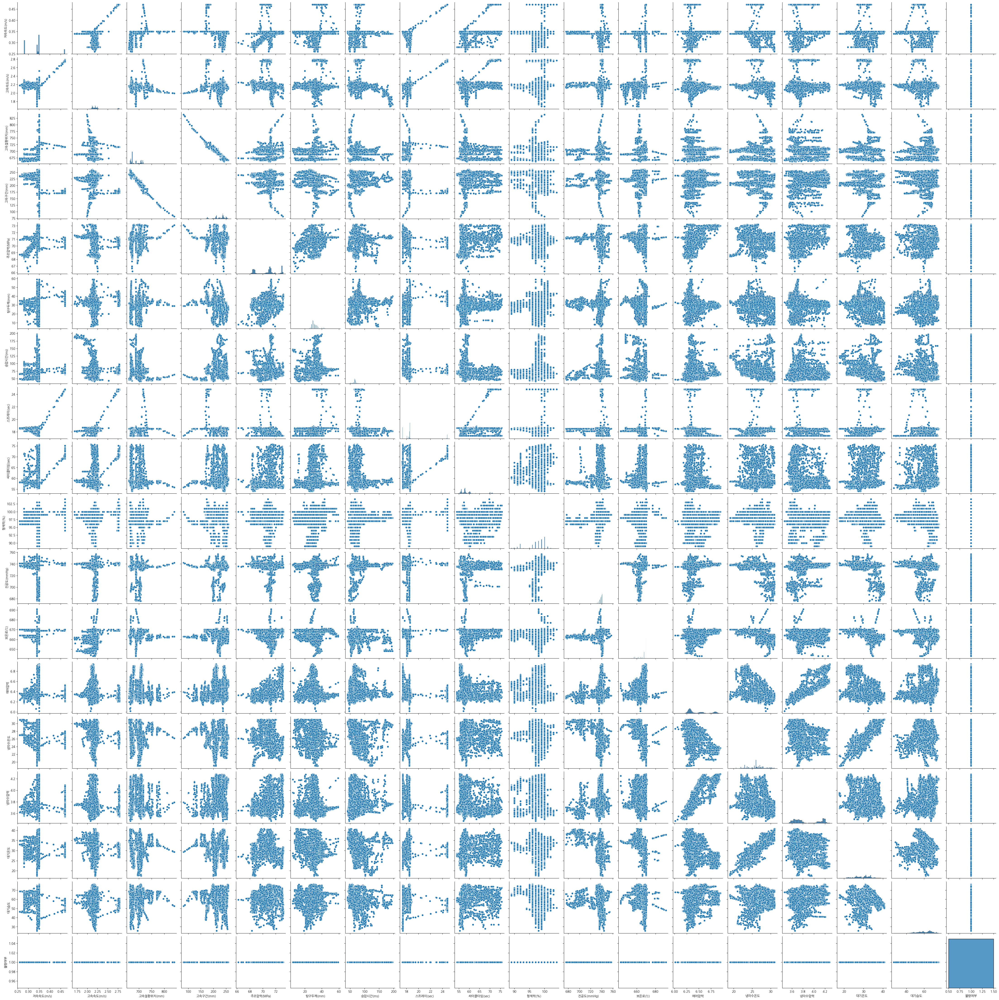

In [ ]:
#불량
sns.pairplot(df_false[[
    "저속속도(m/s)",
    "고속속도(m/s)",
    "고속절환위치(mm)",
    "고속구간(mm)",
    "주조압력(MPa)",
    "탕구두께(mm)",
    "승압시간(ms)",
    "스프레이(sec)",
    "싸이클타임(sec)",
    "형체력(%)",
    "진공도(mmHg)",
    "보온로(℃)",
    "에어압력",
    "냉각수온도",
    "냉각수압력",
    "대기온도",
    "대기습도",
    "불량여부"]])

불량데이터에서 스프레이가 특정 값 이상일 때 갑자기 다른 변수들과 선형성이 나타난다.

(특히 저속속도, 고속속도, 싸이클타임)

저속속도-고속속도 또한 특정 값 이상 범위에서는 선형성을 나타낸다.

##히트맵-상관계수

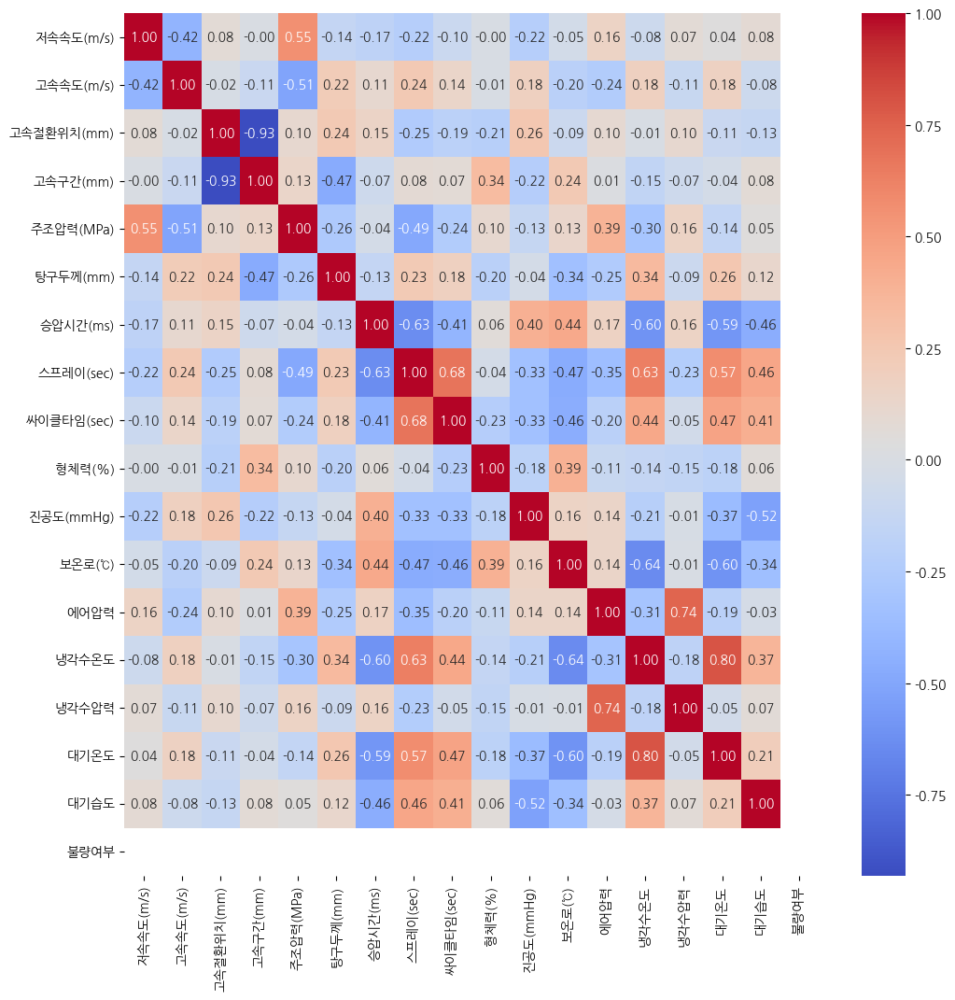

In [ ]:
#양품
corr=df_true.corr()
plt.figure(figsize=(12,12))
sns.heatmap(corr,annot=True,cmap="coolwarm",fmt=".2f")
plt.show()

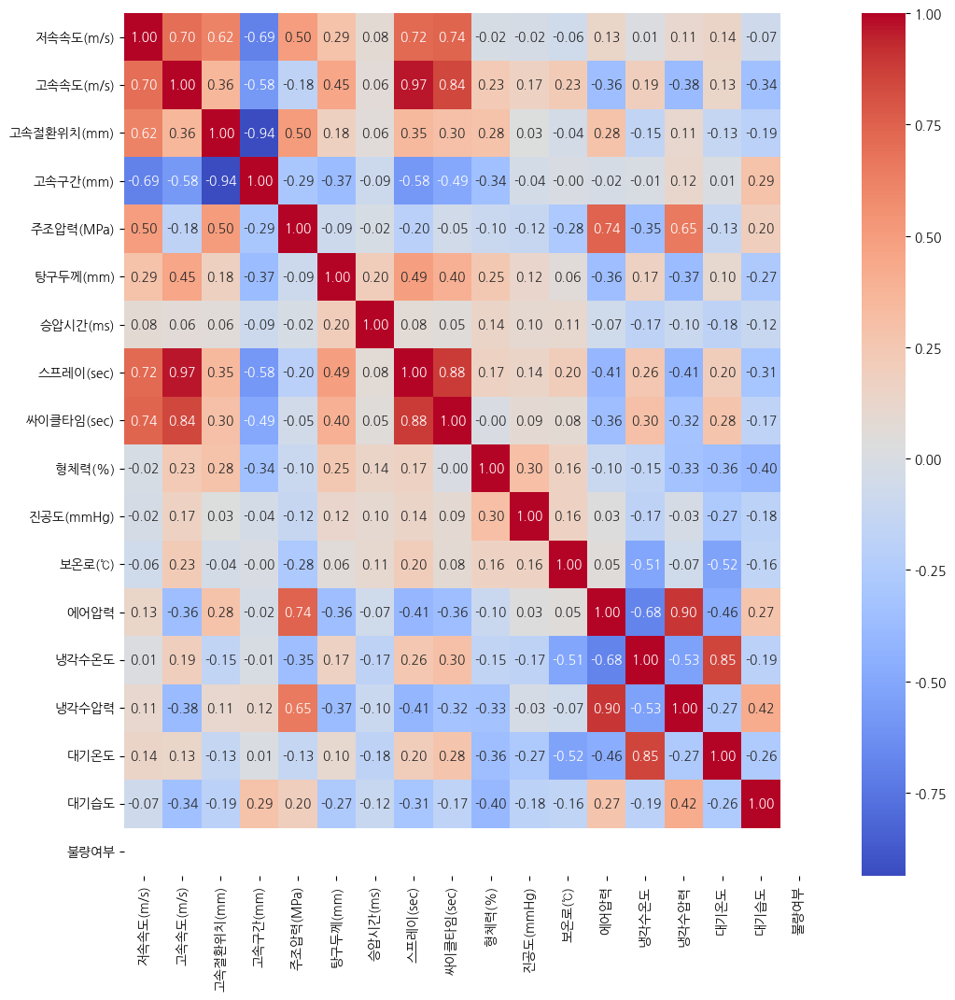

In [ ]:
#불량
corr=df_false.corr()
plt.figure(figsize=(12,12))
sns.heatmap(corr,annot=True,cmap="coolwarm",fmt=".2f")
plt.show()

역시나 특정 변수들이 불량 데이터에서 상당히 높은 상관계수를 가진다.

##저속속도-고속속도-스프레이 연관성

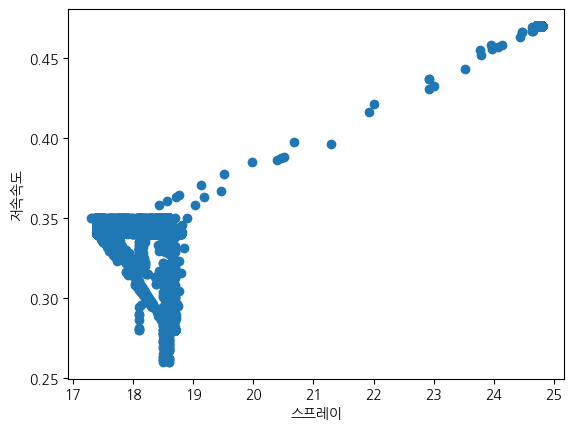

In [ ]:
#불량: 저속속도 - 스프레이
plt.scatter(df_false['스프레이(sec)'],df_false['저속속도(m/s)'])
plt.ylabel('저속속도')
plt.xlabel('스프레이')
plt.show()

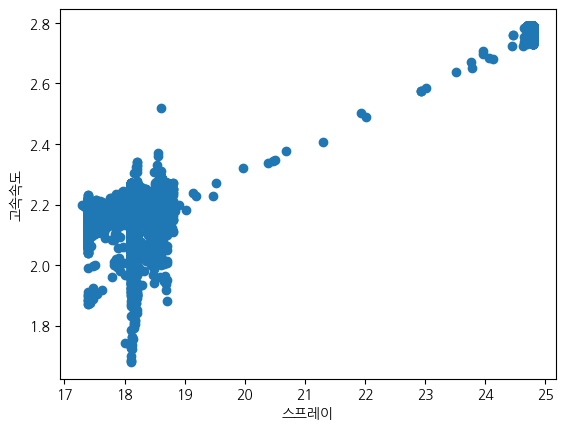

In [ ]:
#불량: 고속속도 - 스프레이
plt.scatter(df_false['스프레이(sec)'],df_false['고속속도(m/s)'])
plt.ylabel('고속속도')
plt.xlabel('스프레이')
plt.show()

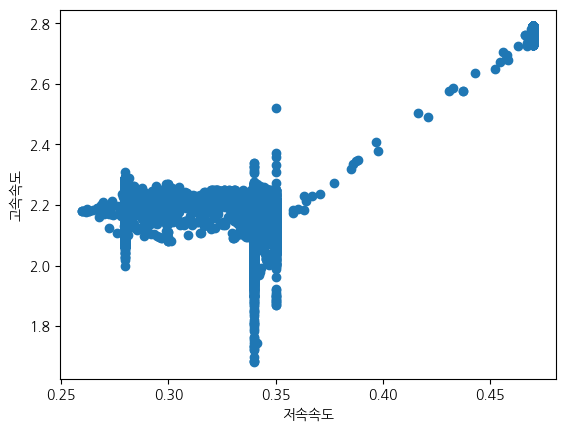

In [ ]:
#불량: 저속속도 - 고속속도
plt.scatter(df_false['저속속도(m/s)'],df_false['고속속도(m/s)'])
plt.ylabel('고속속도')
plt.xlabel('저속속도')
plt.show()

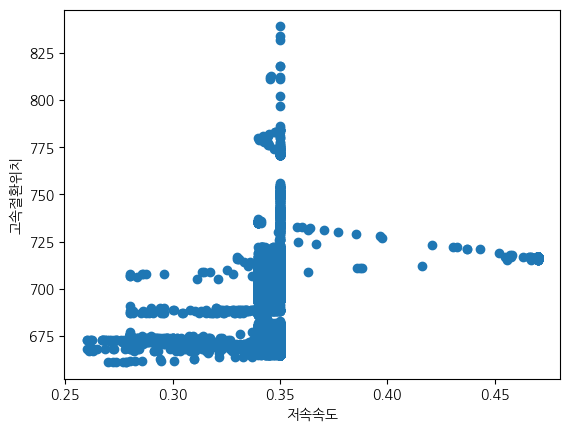

In [ ]:
#불량: 저속속도 - 고속속도
plt.scatter(df_false['저속속도(m/s)'],df_false['고속절환위치(mm)'])
plt.ylabel('고속절환위치')
plt.xlabel('저속속도')
plt.show()

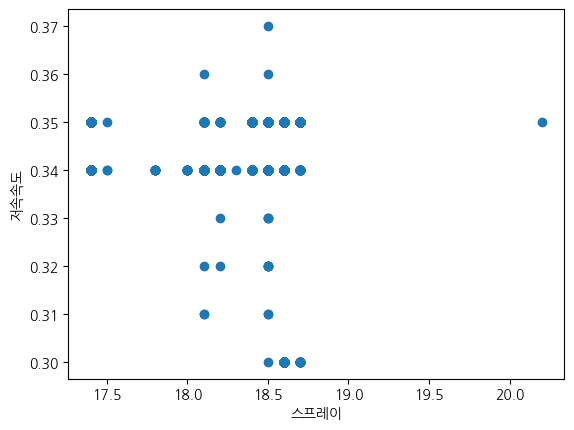

In [ ]:
#양품: 저속속도 - 스프레이
plt.scatter(df_true['스프레이(sec)'],df_true['저속속도(m/s)'])
plt.ylabel('저속속도')
plt.xlabel('스프레이')
plt.show()

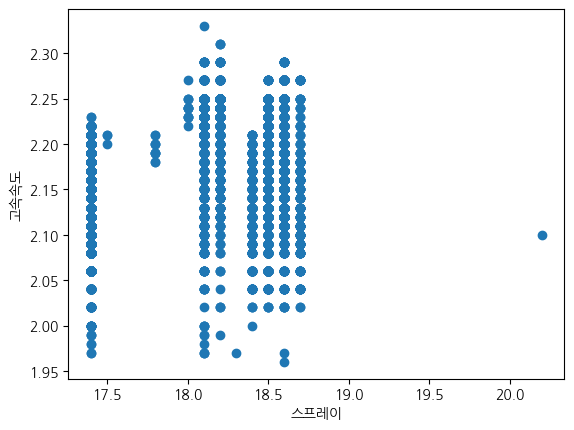

In [ ]:
#양품: 고속속도 - 스프레이
plt.scatter(df_true['스프레이(sec)'],df_true['고속속도(m/s)'])
plt.ylabel('고속속도')
plt.xlabel('스프레이')
plt.show()

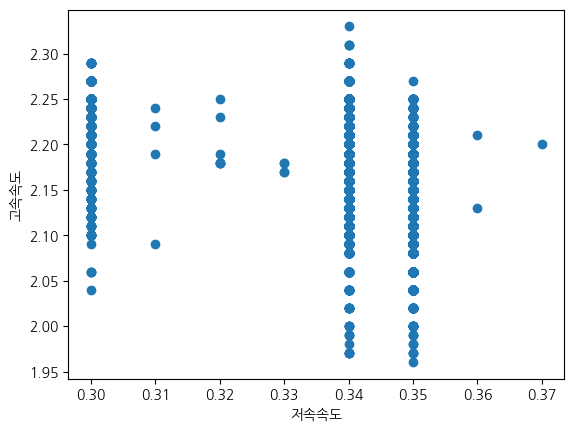

In [ ]:
#양품: 저속속도 - 고속속도
plt.scatter(df_true['저속속도(m/s)'],df_true['고속속도(m/s)'])
plt.ylabel('고속속도')
plt.xlabel('저속속도')
plt.show()

#가설

---

가설 중간점검

1. 불량률과 저속속도는 높은 영향 관계에 있는 것으로 보인다.

2. 저속속도는 특히 제품이 불량인 상황에서 다른 변수들과 높은 영향력을 가지는 것으로 보인다.

3. 따라서 상대적으로 초기 공정 변수에 해당하는 저속속도의 값이 잘못 설정되면 그것이 다른 변수의 효과에도 영향을 미칠 것이라고 생각해 볼 수 있다.(특히 고속속도, 스프레이와 높은 상관관계를 가진다.)

- 다만, 저속속도 -> 스프레이 방향으로 영향이 가는 것이 아닌 스프레이 -> 저속속도 방향으로 영향을 줄 가능성 있음
- 불량일때와 양품일때 각 변수 간 상관관계가 확연이 달라지는 것이 나타난다. 이유가 무엇일까


확인해야 할 부분
- 스프레이 시간 19초 이상의 데이터가 몇 개 인가(충분한가?)
- 스프레이 시간에 대해서는 이미 현장직 분들도 인지하고 있는 사항이 아닌가?
- 스프레이의 영향력이 많이 큰가? 좀 더 정확한 도메인 자료 필요

In [ ]:
#스프레이 시간 19초 이상의 데이터가 몇 개인가
df[df['스프레이(sec)']>=19].count()

,0
저속속도(m/s),4116
고속속도(m/s),4116
고속절환위치(mm),4116
고속구간(mm),4116
주조압력(MPa),4116
탕구두께(mm),4116
승압시간(ms),4116
스프레이(sec),4116
싸이클타임(sec),4116
형체력(%),4116


전체 불량률의 약 10%, 전체 데이터의 5%

스프레이 시간관 저속속도는 있지만 한 사이클 내에서의 순서, 시간 정보가 없어서 섣불리 연관성을 판단하기 어려움 => 보류

(다만 일반적인 공정 순서를 생각해보면 저속속도 -> 고속절환위치 -> 고속속도 -> 스프레이 순일 것 같음)

데이터셋에 시간, 순서 관련 정보가 없으므로 인과관계를 논의할 수 없다.

---

##박스플롯

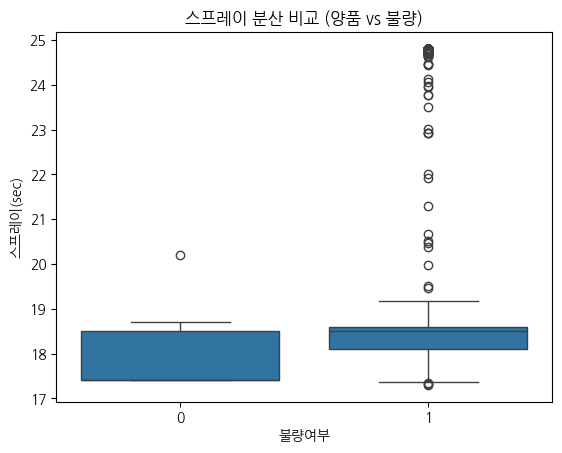

In [ ]:
sns.boxplot(x='불량여부', y='스프레이(sec)', data=df)
plt.title("스프레이 분산 비교 (양품 vs 불량)")
plt.show()

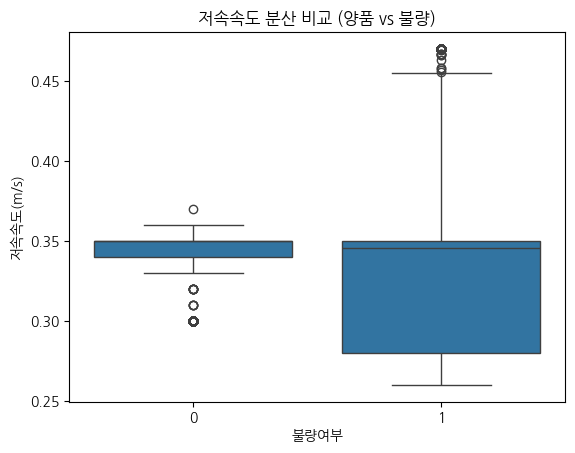

In [ ]:
sns.boxplot(x='불량여부', y='저속속도(m/s)', data=df)
plt.title("저속속도 분산 비교 (양품 vs 불량)")
plt.show()

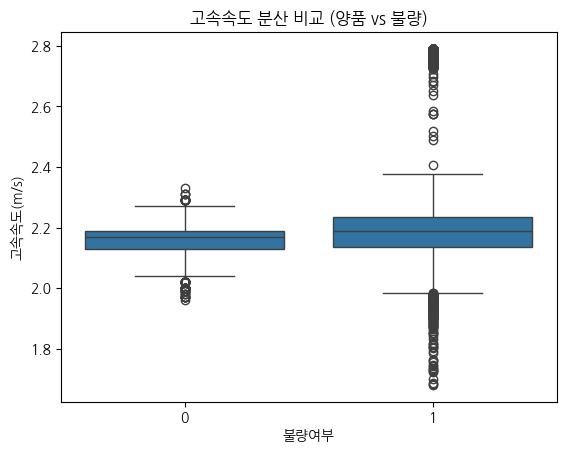

In [ ]:
sns.boxplot(x='불량여부', y='고속속도(m/s)', data=df)
plt.title("고속속도 분산 비교 (양품 vs 불량)")
plt.show()

공정 안정성에 대한 문제일수 있다?

현재 불량 데이터는 양품 데이터보다 값들의 편차가 크다. 즉 공정이 안정적으로 운영되지 않은 경우이다.

현재 박스플롯 상 평균은 비슷해보이지만 분산이 매우 다를 것으로 보인다.

우선 각 공정 변수들의 편차를 줄이는 것은 필수이다.

---

그나마 확실한 것
1. 공정 변수들의 편차가 크면(안정적이지 않으면) 불량이 발생한다.

2. 그리고 이때 변수들이 서로가 서로에게 영향을 미치게 되므로 상관관계도 높아진다. 즉, 하나가 이상치가 크게 발생하면 줄줄이 소세지가 될 가능성이 높다.

가설
- 그렇다면 이 줄줄이 소세지의 시작점이 저속속도일 확률이 높다.
- 영향을 가장 크게 미친다

---

##등분산성 검정

In [ ]:
from scipy import stats
statistic, p_value = stats.levene(df_true['저속속도(m/s)'],df_false['저속속도(m/s)'])

print("Levene 통계량:", statistic)
print("p-value:", p_value)

Levene 통계량: 22000.072341792802
p-value: 0.0


In [ ]:
from scipy import stats
statistic, p_value = stats.levene(df_true['고속속도(m/s)'],df_false['고속속도(m/s)'])

print("Levene 통계량:", statistic)
print("p-value:", p_value)

Levene 통계량: 6473.664887367588
p-value: 0.0


In [ ]:
from scipy import stats
statistic, p_value = stats.levene(df_true['스프레이(sec)'],df_false['스프레이(sec)'])

print("Levene 통계량:", statistic)
print("p-value:", p_value)

Levene 통계량: 3128.7624554530225
p-value: 0.0


In [ ]:
from scipy import stats
statistic, p_value = stats.levene(df_true['고속절환위치(mm)'],df_false['고속절환위치(mm)'])

print("Levene 통계량:", statistic)
print("p-value:", p_value)

Levene 통계량: 1248.0131308396797
p-value: 1.8753385069756535e-271


일단 저속속도가 분산 차이가 엄청 많이 난다는 건 알겠다

너무 작거나 너무 큰 저속속도는 불량에 영향을 미친다.

#머신러닝

##Elastic Net

우선 영향력 보는 용도

In [ ]:
X=df.copy()

In [ ]:
X=X.drop('불량여부',axis=1)

In [ ]:
X

,저속속도(m/s),고속속도(m/s),고속절환위치(mm),고속구간(mm),주조압력(MPa),탕구두께(mm),승압시간(ms),스프레이(sec),싸이클타임(sec),형체력(%),진공도(mmHg),보온로(℃),에어압력,냉각수온도,냉각수압력,대기온도,대기습도
0,0.340000,2.190000,708,201,68.700000,31,102,18.500000,58.400000,98,742,666,6.420000,21.667000,3.928000,17.471000,61.838000
1,0.340000,2.190000,709,199,68.800000,31,102,18.500000,58.200000,98,741,666,6.433000,21.667000,3.957000,17.492000,61.809000
2,0.340000,2.200000,695,210,68.400000,35,125,18.500000,58.400000,97,738,670,6.297000,19.000000,3.689000,17.671000,64.666000
3,0.340000,2.190000,696,210,68.500000,35,122,18.500000,58.400000,97,739,670,6.243000,19.000000,3.705000,17.737000,64.543000
4,0.340000,2.190000,706,202,68.700000,34,118,18.500000,58.400000,98,738,670,6.287000,19.000000,3.728000,17.875000,64.825000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87283,0.340000,2.232041,689,226,71.420407,34,84,18.100000,56.044881,98,738,658,6.344081,28.554217,3.812919,34.842239,56.733446
87284,0.340000,2.200000,695,220,71.100000,30,71,18.411622,60.430267,92,736,669,6.523947,25.705702,4.170765,30.343448,74.228078
87285,0.345732,2.102804,710,211,72.857321,29,67,17.400000,56.300000,99,738,668,6.860072,23.000000,4.180121,22.671038,65.282479
87286,0.350000,2.120000,709,212,73.000000,30,66,17.400000,56.300000,99,738,668,6.877349,22.000000,4.267018,22.153813,66.859814


In [ ]:
y=df['불량여부']

In [ ]:
#분할
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
	X,y,test_size=0.2,stratify=y,random_state=42)
#train:test=0.8:0.2

In [ ]:
#스케일링
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error

In [ ]:
# 모델 정의
# alpha=0.1, l1_ratio=0.5로 설정
# alpha: 규제 강도
# l1_ratio: L1 페널티와 L2 페널티의 비율
elastic_net_model = ElasticNet(alpha=0.1, l1_ratio=0.5, random_state=42)

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
param_grid = {
    'alpha': np.logspace(-4, 0, 10),  # 0.0001부터 1.0까지 10개 값
    'l1_ratio': np.arange(0.1, 1.1, 0.2) # 0.1부터 1.0까지 0.1 간격으로
}

In [ ]:
grid_search = GridSearchCV(
    estimator=ElasticNet(random_state=42),
    param_grid=param_grid,
    scoring='roc_auc',
    cv=5,
    n_jobs=-1
)

In [ ]:
grid_search.fit(X_train_scaled, y_train)

/usr/local/lib/python3.12/dist-packages/sklearn/model_selection/_search.py:1108: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
  warnings.warn(


GridSearchCV(cv=5, estimator=ElasticNet(random_state=42), n_jobs=-1,
             param_grid={'alpha': array([1.00000000e-04, 2.78255940e-04, 7.74263683e-04, 2.15443469e-03,
       5.99484250e-03, 1.66810054e-02, 4.64158883e-02, 1.29154967e-01,
       3.59381366e-01, 1.00000000e+00]),
                         'l1_ratio': array([0.1, 0.3, 0.5, 0.7, 0.9])},
             scoring='roc_auc')

In [ ]:
best_model = grid_search.best_estimator_

In [ ]:
y_pred = best_model.predict(X_test_scaled)

In [ ]:
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report

# y_test는 실제 이진 레이블
# y_pred_proba는 모델이 반환한 확률 (예: .predict_proba()의 결과)

# y_pred_proba가 2차원 배열일 경우, 불량(1)에 대한 확률만 추출
y_pred_proba_positive = y_pred

# 임계값 0.5를 기준으로 이진 예측값 생성
threshold = 0.5
y_pred_binary = (y_pred_proba_positive >= threshold).astype(int)

In [ ]:
print("분류 보고서:\n", classification_report(y_test, y_pred_binary))

분류 보고서:
               precision    recall  f1-score   support

           0       0.89      0.90      0.90      8729
           1       0.90      0.89      0.90      8729

    accuracy                           0.90     17458
   macro avg       0.90      0.90      0.90     17458
weighted avg       0.90      0.90      0.90     17458



In [ ]:
from sklearn.metrics import roc_auc_score

roc_auc = roc_auc_score(y_test, y_pred_proba_positive)
print(f"ROC-AUC 점수: {roc_auc:.4f}")

ROC-AUC 점수: 0.9648


In [ ]:
#df로 변환
X_train_df = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_df  = pd.DataFrame(X_test_scaled,  columns=X_train.columns)

In [ ]:
import shap
explainer=shap.LinearExplainer(best_model,shap.maskers.Independent(X_train_df))
shap_values=explainer(X_test_df)

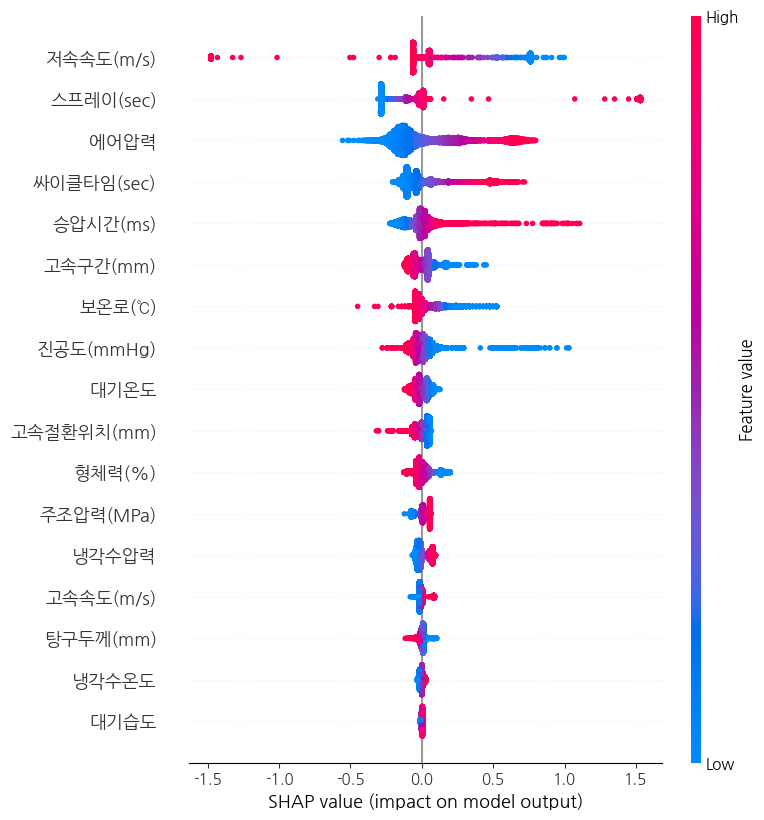

In [ ]:
shap.summary_plot(shap_values, X_test_df)

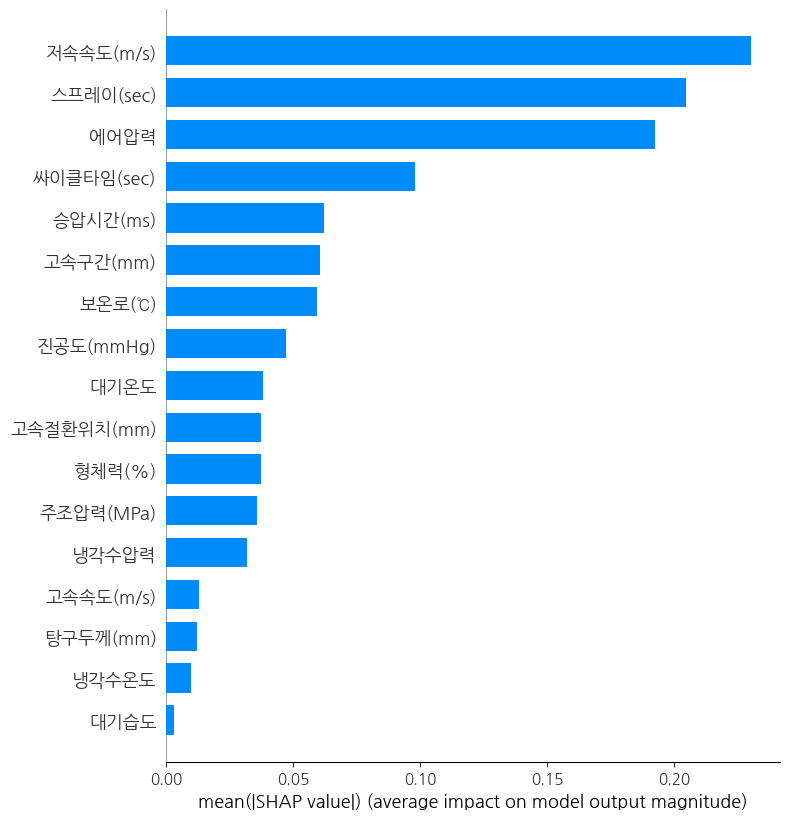

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))

shap.summary_plot(shap_values.values, X_test_scaled, feature_names=X_test.columns,
                  plot_type="bar", show=False)

plt.tight_layout()
plt.show()

In [ ]:
#특성중요도

def print_feature_importance(model, feature_names):
    importances = np.abs(model.coef_)
    indices = np.argsort(importances)[::-1]

    print("Feature importance:")
    for idx in indices:
        print(f"{feature_names[idx]}: {importances[idx]:.4f}")

# 사용 예시
print_feature_importance(best_model, X.columns)

Feature importance:
저속속도(m/s): 0.4360
스프레이(sec): 0.3768
에어압력: 0.2534
싸이클타임(sec): 0.1406
승압시간(ms): 0.0973
보온로(℃): 0.0889
진공도(mmHg): 0.0761
고속구간(mm): 0.0721
형체력(%): 0.0537
대기온도: 0.0458
주조압력(MPa): 0.0440
고속절환위치(mm): 0.0422
냉각수압력: 0.0394
고속속도(m/s): 0.0210
탕구두께(mm): 0.0166
냉각수온도: 0.0121
대기습도: 0.0037
